# Lab Assignment One: Exploring Table Data
by:
    1. Hayden Donofrio
    2. Riley Bates
    3. Chandler Choate

## Section 1: Business Understanding
Today there is quite a bit of interest in tweets related to elections, especially after the 2016 U.S. Presidential Election. The [Australian Election 2019 Tweets](https://www.kaggle.com/taniaj/australian-election-2019-tweets/version/2) data explores this election and includes many interesting attributes, including the user's location and the number of retweets and favorites that the tweet received. 

This dataset includes free text, nominal and ordinal data, and includes over 180,000 tweets that were collected between May 10, 2019 and May 20, 2019.

Any insights gleaned from this dataset would be very important to Australian politicians and campaign managers, and may help them target specific audiences and address various issues or topics. For example, are most of individuals tweeting about the Australian election living in Australia, or are there plenty of people who will not impact the election causing noise on Twitter and weighing in? Which areas of Australia tend to be conservative versus liberal, and which areas seem to be more opiniated? 

By exploring the features in this dataset, we will be able to find interesting relationships that may or may not be self-evident. Further analysis and visualization will be directly beneficial to Australian campaign managers in their decision-making process. To be useful to individuals involved in the campaign, however, there would have to be evident trends in the data. If political opinions and popularity are simply randomly related to geographical area, or there is no clear pattern, then this information will be of no use to managers.

Dataset: https://www.kaggle.com/taniaj/australian-election-2019-tweets/version/2

Question to explore: Who is most concerned about the Australian election and what do popular tweets, specifically highly retweeted tweets, have in common?

In [32]:
import pandas as pd
import numpy as np

df = pd.read_csv('~/Downloads/australian-election-2019-tweets/auspol2019.csv')
df.head()

,created_at,id,full_text,retweet_count,favorite_count,user_id,user_name,user_screen_name,user_description,user_location,user_created_at
0,2019-05-20 09:13:44,1130401208756187136,After the climate election: shellshocked green...,0.0,0.0,9.248486e+07,PIPELINEPETE,jocksjig,Retired Tradesman and Progressive Anti Conserv...,"Brisbane, Queensland",2009-11-25 09:19:45
1,2019-05-20 09:13:43,1130401205367140357,@narendramodi @smritiirani Coverage of indian ...,0.0,0.0,7.756474e+08,Narinder Parmar,nparmar1957,"Life coach & trainer, Motivational speaker, Ma...","Wollongong, NSW, AUSTRALIA",2012-08-23 10:20:40
2,2019-05-20 09:13:33,1130401162782371841,@workmanalice Do you know if Facebook is relea...,0.0,0.0,5.687300e+04,Peter Wells,peterwells,Writes for @theage and @smh on technology and ...,Melbourne,2006-12-11 07:38:06
3,2019-05-20 09:13:29,1130401143551434753,@vanbadham We all understand we have a compuls...,0.0,0.0,9.081660e+17,The Realist,therealist822,"Calls it as I see it. Anti PC, SJW and VS. If ...",NaN,2017-09-14 03:10:30
4,2019-05-20 09:13:23,1130401118666809345,"Shares were mixed in Asia, with India and Aust...",0.0,0.0,5.260074e+08,Inquirer Business,InquirerBiz,The official Twitter account of the Inquirer G...,Philippines,2012-03-16 03:51:59


The most important attributes in the dataset for initial triage will be retweet_count, favorite_count, and user_location. The number of retweets and favorites will be a good indicator on how popular a tweet was. These features can then be mapped to the user's location to determine if there is any correlation there.

Once we begin text analysis, then we can begin parsing through the full_text field, which is the actual text of the tweet, and user_description, which is the user's Twitter bio. At this point, the relationship between number of retweets and specific words and phrases can be examined. Perhaps it is the case that when someone tweets similar words or phrases, they receive more retweets. This will be a very important relationship to examine further.

The created_at attribute is very interesting and could be potentially helpful. This attribute is the date and time of tweet creation, although it would have more significance if the entire dataset was not collected over a 10 day period. However, perhaps there is some relationship between the popularity of a tweet (retweet_count) and when it was created; for example, a tweet sent closer to the election may have seen more popularity.

In [33]:
print(df.dtypes)
print('===========')
df.info()

created_at           object
id                   object
full_text            object
retweet_count       float64
favorite_count      float64
user_id             float64
user_name            object
user_screen_name     object
user_description     object
user_location        object
user_created_at      object
dtype: object
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 183379 entries, 0 to 183378
Data columns (total 11 columns):
created_at          183379 non-null object
id                  183379 non-null object
full_text           183379 non-null object
retweet_count       183370 non-null float64
favorite_count      183370 non-null float64
user_id             183370 non-null float64
user_name           183358 non-null object
user_screen_name    183370 non-null object
user_description    167659 non-null object
user_location       146485 non-null object
user_created_at     183361 non-null object
dtypes: float64(3), object(8)
memory usage: 15.4+ MB


### Data Cleaning

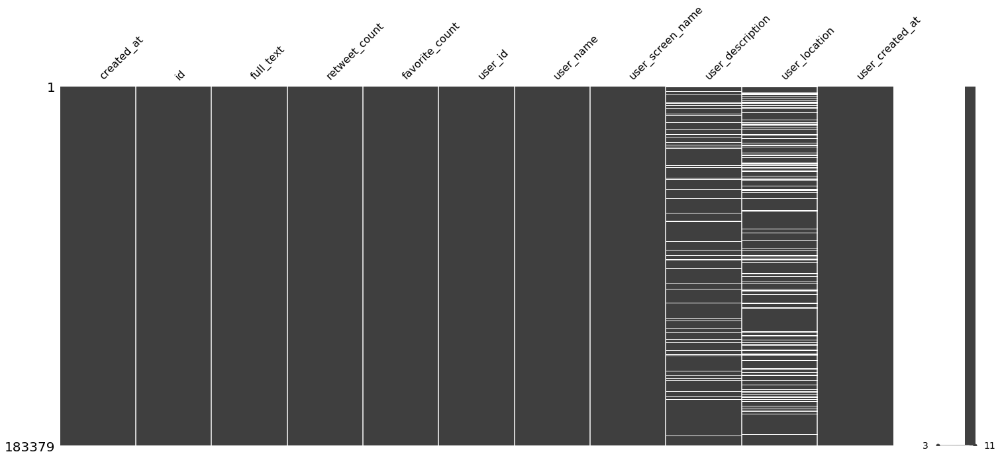

In [34]:
import matplotlib
import matplotlib.pyplot as plt
import warnings
warnings.simplefilter('ignore', DeprecationWarning)
%matplotlib inline 

import missingno as mn

mn.matrix(df.sort_values(by=["retweet_count","favorite_count"]))

The graphic above visualizes the missing data in our twitter dataset. It is very evident that only two attributes have any missing data: user_description and user_location. This is probably because a user is not required to fill out their description and can opt out of location tracking services. All other fields are required for either a user, or a tweet, to be created, and the id and created_at fields are generated automatically by Twitter.

This is slightly troublesome, because user_location is one of the attributes that we were hoping to use. Since it is not really possible to impute someone's description of themselves, we will be forced to ignore these entries. It is not advisable to attempt to impute user_location either, since grouping other attributes of the dataset that are similar does not help us. Many different people live in the same location, so the diversity of a city or location's population prevents imputed data. Since removing any entries with missing data would remove over 43,000 records from the dataset, we will simply ignore any records with missing location entries when grouping by location. 

In [35]:
#this block is forcing all invalid datetimes and ids to be of the correct type
df["created_at"] = pd.to_datetime(df["created_at"], errors="coerce")
df["id"] = pd.to_numeric(df["id"], errors="coerce")
df["retweet_count"] = pd.to_numeric(df["retweet_count"], errors="coerce")
df["user_created_at"] = pd.to_datetime(df["user_created_at"], errors="coerce")
df["user_created_at"].min()


Timestamp('2006-03-21 21:04:12')

In [36]:
# describe each data type and its contents
desc = pd.DataFrame()
desc["Column"] = df.columns

desc["Description"] = [
    "Date on which the tweet was posted",
    "ID of the tweet",
    "Full tweet text",
    "Number of retweets",
    "Number of likes",
    "User ID of user who posted the tweet",
    "Username of user who posted the tweet",
    "Screen name of user who posted the tweet",
    "Free text description on profile of user who posted the tweet",
    "Free text location on profile of user who posted the tweet",
    "Date of create of account of user who posted the tweet"
]
#date is ordinal

desc["Scales"] = ['ordinal'] + ['nominal'] + ['ordinal'] + ['ratio'] * 2 + ['nominal'] *5 + ['ordinal'] 
#find out ranges
#there are some dates that aren't date ranges
#todo: Before coercing this values we should see everything that we have (or maybe after for seeing if it is a lot)

desc["Ranges"] = [
    "{} - {}".format(df['created_at'].min(), df['created_at'].max()),
    "{} - {}".format(df['id'].min(),df['id'].max()),
    "N/A",
    "0 - {}".format(df['retweet_count'].max()),
    "0 - {}".format(df['favorite_count'].max()),
    "N/A",
    "N/A",
    "N/A",
    "N/A",
    "N/A",
    "{} - {}".format(df["user_created_at"].min(), df["user_created_at"].max())
]
desc

,Column,Description,Scales,Ranges
0,created_at,Date on which the tweet was posted,ordinal,2019-05-10 16:58:15 - 2019-05-20 11:40:07
1,id,ID of the tweet,nominal,1.1268942292071711e+18 - 1.1304380453106729e+18
2,full_text,Full tweet text,ordinal,N/A
3,retweet_count,Number of retweets,ratio,0 - 6622.0
4,favorite_count,Number of likes,ratio,0 - 15559.0
5,user_id,User ID of user who posted the tweet,nominal,N/A
6,user_name,Username of user who posted the tweet,nominal,N/A
7,user_screen_name,Screen name of user who posted the tweet,nominal,N/A
8,user_description,Free text description on profile of user who p...,nominal,N/A
9,user_location,Free text location on profile of user who post...,nominal,N/A


In [37]:
# find the duplicate instances and drop these rows
print(len(df))
df.drop_duplicates(subset ="id", 
                     keep = False, inplace = True) 
print(len(df))

183379
183336


There were 43 rows that did not have a unique identifier. These is the most important indicator for what is a tweet since this is how twitter differentiates each tweet. We decided to drop these since they most likely have other faulty columns as well.

## Section 3: Data Visualization
We're mainly going to be exploring retweets and likes. We'll assume that the timezone is UTC since datetime is not specified.
Check https://developer.twitter.com/en/docs/ads/general/guides/timezones.html for proof that twitter stores in UTC.
 were going to
 1. gather data with created at tweet date and retweet count and like count
  - group by day for each
  - Take the day with the most retweets and do a group by hour on that time
 2. then we are going to look at account created at retweet count and like count
   - we can do a group by year here



In [21]:
#turn these into graphs
import plotly.graph_objs as go
import plotly.express as px
tips = px.data.tips()
groups = df.set_index('created_at').groupby(pd.Grouper(freq='D')).mean()
strs = [pd.to_datetime(i).strftime("%B %d, %Y") for i in groups.index.values]
layout = go.Layout(
    title='Average Likes And Retweets Per Day Posted',
    xaxis=dict(
        title='Day'
    ),
    yaxis=dict(
        title='Avg. Likes/Retweets'
        
    )
)
fig = go.Figure(data = [
    go.Bar(
        name='Retweets',
        x= strs, # assign x as the dataframe column 'x'
        y=groups['retweet_count']
    ),
    go.Bar(
        name='Likes',
        x=strs, # assign x as the dataframe column 'x'
        y=groups['favorite_count']
    )
], layout= layout)

fig.update_layout(barmode='stack')
fig.show()

Since the tweets in the dataset were gather over a 10 day period, there is not much breadth of data to be covered. However, we will examine how the date a tweet was posted relates to the number of likes/retweets. For example, one might assume that tweets posted closer to the election would receive more retweets as public awareness is at its peak. 

There is not much of a noticeable trend, other than a decline in both likes and retweets after May 17 or 18. This actually makes sense as the [2019 Australian elections were held on May 18](https://en.wikipedia.org/wiki/2019_Australian_federal_election), so after this, the hype seems to die down rather quickly. 

In [22]:
groups = df.query('created_at >= "May 11 00:00:00 2019" & created_at <= "May 11 23:59:59 2019"').set_index('created_at').groupby(pd.Grouper(freq='H')).count()


In [23]:
#i picked this day since it was the "FULL DAY" with  the highest retweet count
#this section shows which hours UTC have the highest mean retweet count
#we can see that it is at 1 AM UTC which is between  9 AM and 11 AM in Australia depending on Time Zone. (NO DST)
#11AM based on the time in Sydney
df.query('created_at >= "May 11 00:00:00 2019" & created_at <= "May 11 23:59:59 2019"').set_index('created_at').groupby(pd.Grouper(freq='H')).mean()

strs = [pd.to_datetime(i).strftime("%H") for i in groups.index.values]
layout = go.Layout(
    title='Plot Title',
    xaxis=dict(
        title='Hour Posted'
    ),
    yaxis=dict(
        title='Avg. Likes/Retweets'
        
    )
)
fig = go.Figure(data = [
    go.Bar(
        name='Retweets',
        x= strs, # assign x as the dataframe column 'x'
        y=groups['retweet_count']
    ),
    go.Bar(
        name='Likes',
        x=strs, # assign x as the dataframe column 'x'
        y=groups['favorite_count']
    )
], layout= layout)
fig.update_layout(barmode='stack', title="Likes/Retweets Per Hour on May 11th")
fig.show()

We can now choose a specific day and examine how the time of day that a tweet was posted impacts the likes and retweets it received (May 11th was chosen because this day has the largest amount of data). Since we know that the [Twitter API uses UTC time format for their API](https://developer.twitter.com/en/docs/ads/general/guides/timezones.html), we can compare this to Sydney time, which is [10 hours ahead](https://www.timeanddate.com/worldclock/converted.html?p1=240&p2=0). 

With this information, the trend of retweets and likes based on hours makes sense. There is a steady drop of retweets, which the lowest point between 16:00 and 19:00, which in AEST time (Sydney to New South Wales), is the 2AM-5AM time range. I know that I wouldn't be retweeting political or election tweets at that time in the morning, let alone any other subject matter. 

According to the data, the most retweets and likes actually occured at 9AM AEST and slowly dwindled again, with a local peak around 5PM. This lines up with a standard work schedule, and may support that many people check Twitter in the morning before work and right as they get off.

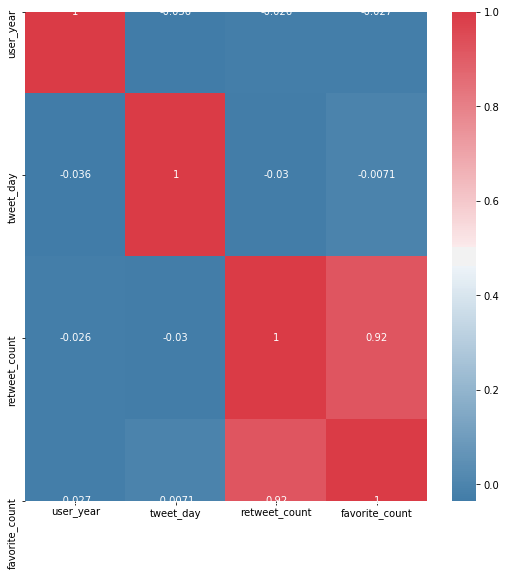

In [24]:
import seaborn as sea
import matplotlib.pyplot as p

# Extract the year the user created their account, and which day the tweet was posted
df['created_at'] = pd.to_datetime(df['created_at'])
df['user_year'] = df['user_created_at'].dt.year
df['tweet_day'] = df['created_at'].dt.day

cmap = sea.diverging_palette(240, 10, n=7, as_cmap=True)

f, ax = p.subplots(figsize=(9,9))
# sea.heatmap(df.corr(), cmap=cmap, annot=True)
sea.heatmap(df[['user_year', 'tweet_day', 'retweet_count','favorite_count']].corr(), cmap=cmap, annot=True)

The above heat map shows correlation between the number of retweets and likes, the day the tweet was posted, and the year the user created their Twitter account. Unsurprisingly, there is a very strong positive correlation between the number of retweets and the number of likes a tweet receives. 

However, one surprise is the lack of correlation between user_year and retweet_count. Logically, one might assume that a user that has been on Twitter for a longer period of time would have more retweets and/or likes than a newer user, as they have had time to build their network and gain more followers. However, there is essentially no correlation between how long a user has had their account and their retweets. I guess you actually just have to have good content... 

Let's examine this relationship in more detail.

In [25]:
#now group by year for created at
#NOTE: WE MIGHT WANT TO NORMALIZE THIS
groups = df.set_index('user_created_at').groupby(pd.Grouper(freq='Y')).count()
strs = [pd.to_datetime(i).strftime("%Y") for i in groups.index.values]
layout = go.Layout(
    title="Total Likes/Retweets Based On User Created At",
    xaxis=dict(
        title='Year of User Creation'
    ),
    yaxis=dict(
        title='Total Likes/Retweets'
        
    )
)
fig = go.Figure(data = [
    go.Bar(
        name='Retweets',
        x= strs, # assign x as the dataframe column 'x'
        y=groups['retweet_count']
    ),
    go.Bar(
        name='Likes',
        x=strs, # assign x as the dataframe column 'x'
        y=groups['favorite_count']
    )
],  layout=layout)
fig.update_layout(barmode='stack')
fig.show()

Although there is a general downward trend, this graph seems to support the conclusion we drew from the heatmap: longer time on Twitter does not necessarily mean more retweets. While there are is a spike from Twitter users who created their account in 2009, users who have been around even longer, like from 2007, do not have as many total retweets and likes.

However, maybe this is just because we don't have as much data from users who have had a Twitter account for that amount of time, simply because there are not as many. Let's look at the average retweets and likes instead.

In [26]:
groups = df.set_index('user_created_at').groupby(pd.Grouper(freq='Y')).mean()
strs = [pd.to_datetime(i).strftime("%Y") for i in groups.index.values]
layout = go.Layout(
    xaxis=dict(
        title='Year of User Creation'
    ),
    yaxis=dict(
        title='Avg. Likes/Retweets'
        
    )
)
fig = go.Figure(data = [
    go.Bar(
        name='Retweets',
        x= strs, # assign x as the dataframe column 'x'
        y=groups['retweet_count']
    ),
    go.Bar(
        name='Likes',
        x=strs, # assign x as the dataframe column 'x'
        y=groups['favorite_count']
    )
])
fig.update_layout(barmode='stack', title="Average per year Likes/Retweets Based on user created at")
fig.show()

The figure above indicates the relationship that we would have guessed at without looking at the dataset: on average, users who have had their Twitter account for longer, and hence may have more followers, have a higher amount of likes and retweets. This graph shows this relationship very visibly, while the total retweets/like graph above did not seem to indicate any such correlation.

In [38]:
#this block is downcasing every word in the full text section so we can have an accurate comparison
df['full_text'] = df['full_text'].apply(lambda x: str(x).lower())
df['user_description'] = df['user_description'].apply(lambda x: str(x).lower())

In [39]:
#now we are going to do text data on the tweet regarding the words and which words seem to get the most retweets 
#we will need to stem every word in every tweet and remove special characters 
#we will also remove stop words as well
import nltk
import ssl
import string
try:
    _create_unverified_https_context = ssl._create_unverified_context
except AttributeError:
    pass
else:
    ssl._create_default_https_context = _create_unverified_https_context
nltk.download('stopwords')
stop = nltk.corpus.stopwords.words('english')
#applying stop words... this may take a while
#above line takes too fucking long! just remove the stop words from the matrix after we have our bag of words
stop += list(string.ascii_lowercase)
stop.append("co")

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/haydendonofrio/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [40]:
import re
#df['team'] =  df['team'].apply(lambda x: re.sub(r'[\n\r]*','', str(x)))
#this removes all special characters from every tweet
df['full_text'] = df['full_text'].apply(lambda x: re.sub(r'[^a-zA-Z#]', ' ', str(x)))
df['full_text'][0]

'after the climate election  shellshocked green groups remain resolute https   t co wyjzmacyid'

In [41]:
#stemming words... this is going to take a while
from nltk.stem import PorterStemmer, WordNetLemmatizer
stemmer = PorterStemmer()

#This code was taken from this very smart stackoverflow answer 
#https://stackoverflow.com/questions/43795310/apply-porters-stemmer-to-a-pandas-column-for-each-word
#we are filtering out all one letter words and the word co since those are significant when building links in twitter
df['full_text'] = df['full_text'].apply(lambda x: ' '.join([word for word in x.split() if word not in (stop)]))
def stem_shorten(sentence):
    words = sentence.split()
    stemmed_tokens = [stemmer.stem(word) for word in words]
    return ' '.join(stemmed_tokens)
#we should also remove any one letter words and co since that is how twitter builds links

df['full_text'] = df['full_text'].apply(stem_shorten)

In [42]:
#now that we have all of our stemming and regex applied, we can get our bag of words and our tf idf for retweets
from sklearn.feature_extraction.text import CountVectorizer
count_vect = CountVectorizer()
#we should show this normalized and not normalized
#not sure how to do this correlation between text data and table data in one line
#so heres a hash that gets a word and adds its score from the retweet count
word_scores = {}
index = 0
for col in df['full_text']:
    for word in col.split():
        if word in word_scores:
            try:
                score = df['retweet_count'][index]
                word_scores[word] += score
            except:
                break
        else:
            score =  df['retweet_count'][index]
            word_scores[word] = score
    index += 1
    #now divide by the number of rows
#get the highest words

climatclimatclimatclimatclimatclimatclimatclimatclimatclimat


'climat climat climat climat climat climat climat climat climat climat climat climat climat climat cl'

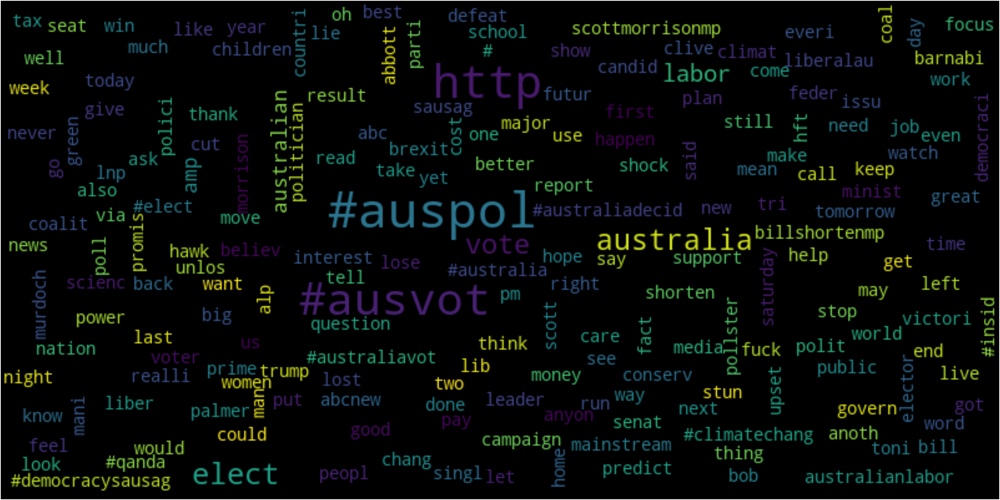

In [44]:
#this code is modified from the example from: https://github.com/amueller/word_cloud/blob/master/examples/simple.py
from wordcloud import WordCloud

import matplotlib.pyplot as plt
wordcloud = WordCloud(width=800, height=400, max_font_size=40).generate_from_frequencies(word_scores)
plt.figure()
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.rcParams["figure.figsize"] = [160,90]
plt.show()

These are the words that people used most frequently that received a high number of retweets and likes. We made a decision to leave hashtags in the dataset since they are how certain users search for tweets. Most have to do with the Australian election or a certain candidate, policy, or issue. We see that #auspol and #ausvot has a very high correlation to high retweet numbers. Admittedly the dataset creator did filter Twitter's API results with keywords like auspol so honestly it is not surprsing we see auspol and ausvot as the two biggest results. Many popular tweets also have an embedded link in them too. This may be because more popular tweets may link to something like a video or image.

In [94]:

#word_scores = {}
#index = 0
##for col in df['full_text']:
#    num_words = float(len(col.split()))
#    for word in col.split():
#        if word in word_scores:
##            try:
 #               score = df['retweet_count'][index]
 #               word_scores[word][0] += (score)
 ##               word_scores[word][1] += 1
  #          except:
 #               break
 #       else:
#            score =  df['retweet_count'][index]
##            word_scores[word] = []
 #           word_scores[word].append(score)
 #           word_scores[word].append(1)
 #   index += 1
 #  #now divide by the number of rows
#word_scores.update((x, (y[0]/len(df.index))) for x, y in word_scores.items())


[('vgwu', 0.03611947462582363),
 ('imigr', 0.01806519177902867),
 ('cfpsjh', 0.017574289828511586),
 ('hrahjjab', 0.013281624994545533),
 ('xoiu', 0.012976174892001572),
 ('meijx', 0.012976174892001572),
 ('aszvqxb', 0.011645285159488589),
 ('hft', 0.011300290177597417),
 ('charalanahzard', 0.009916219400445084),
 ('vhkqrp', 0.007990792861194746),
 ('jrml', 0.0076689793603002135),
 ('ujkkr', 0.0076689793603002135),
 ('dempx', 0.005836278745036436),
 ('kygj', 0.005809006414452153),
 ('teeagmaa', 0.005792643016101584),
 ('lkilsvnov', 0.005667190295413885),
 ('ncord', 0.005530828642492473),
 ('klyh', 0.005530828642492473),
 ('ethjh', 0.005454466116856482),
 ('kevinmpmcnamara', 0.005056290090325959),
 ('georgiahcrfm', 0.005056290090325959),
 ('polhomeeditor', 0.005056290090325959),
 ('gnyicjmtku', 0.005056290090325959),
 ('leakulwjv', 0.0050399266919753894),
 ('jessecox', 0.004958109700222542),
 ('riux', 0.004832656979534843),
 ('citystirlingwa', 0.004832656979534843),
 ('inglewood', 0.004

In [98]:
#sorted_d = sorted(word_scores.items(), key=operator.itemgetter(1), reverse=True)
#dfObj = pd.DataFrame(sorted_d[:100], columns = ['word' , 'score']) 
#fig = px.bar(dfObj, x='word', y='score')
#fig.show()
#GET RID OF THIS

In [47]:
# this will stem and shorten every word in user description
df['user_description'] = df['user_description'].apply(lambda x: re.sub(r'[^a-zA-Z#]', ' ', str(x)))
df['user_description'] = df['user_description'].apply(lambda x: ' '.join([word for word in str(x).split() if word not in (stop)]))

In [48]:

df['user_description'] = df['user_description'].apply(stem_shorten)

In [49]:
#now this section if for getting tfidf scores 
#WRITING THIS NOW SHOULD WE INCLUDE HASHTAGS?
#SCREW THE TFIDF This is about descriptions because tfidf does not seem super helpful compared to the last plot
word_scores = {}
index = 0
for col in df['user_description']:
    for word in str(col).split():
        if word in word_scores:
            try:
                score = df['retweet_count'][index]
                word_scores[word] += score
            except:
                break
        else:
            score =  df['retweet_count'][index]
            word_scores[word] = score
    index += 1
    #now divide by the number of rows
word_scores.update((x, y/len(df.index)) for x, y in word_scores.items())

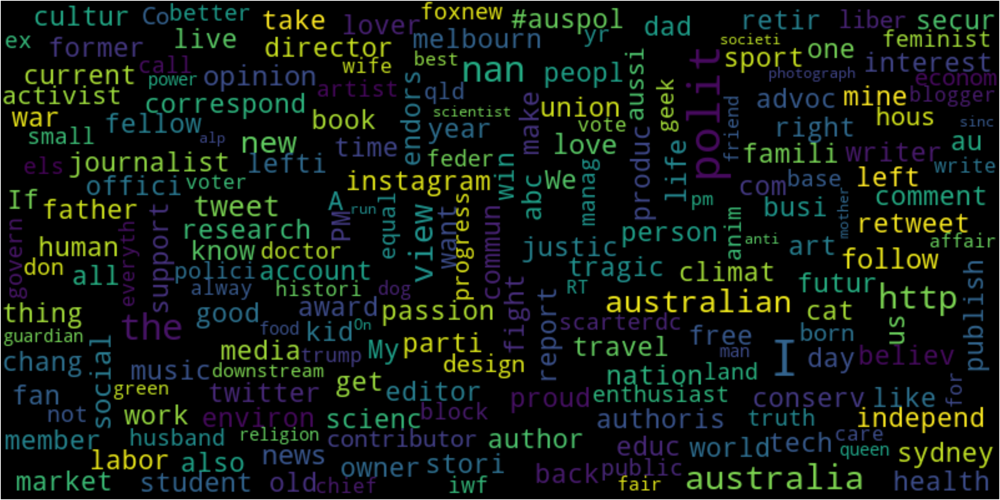

In [50]:
wordcloud = WordCloud(width=800, height=400, max_font_size=40).generate_from_frequencies(word_scores)
plt.figure()
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.rcParams["figure.figsize"] = [160,90]
plt.show()

This is a word cloud of the stemmed user descriptions with the most retweeted tweets. Many of these words are associated with words you would see of a political writer or news account. Many of these words seem either academic or location affiliated. The word most associated to highly retweet accounts is the polit stem, this is most likely associated with a politician tweeting something directly relating to their campaign.

<h1>ADDITIONAL ANALYSIS</h1>
There is a very interesting section of this data that we have yet to explore: location. However, location is never very clear because many users may abbreviate their location or not give a complete location    ex: U.S.A which is very broad location. We will simply place these locations into buckets that was provided to us in the csv.   



In [9]:
locs = pd.read_csv('~/Downloads/australian-election-2019-tweets/location_geocode.csv')
#lets combine loc with df to allow for quick indexing without cross-refrencing
#this may take a while
dframe = df.copy()
dframe["longitude"] = np.nan
dframe["latitude"] = np.nan
for index, row in locs.iterrows():
    dframe.loc[dframe.user_location == row["name"], ['latitude', 'longitude']] = [row['lat'], row['long']]
dframe

,created_at,id,full_text,retweet_count,favorite_count,user_id,user_name,user_screen_name,user_description,user_location,user_created_at,longitude,latitude
0,2019-05-20 09:13:44,1.130401e+18,After the climate election: shellshocked green...,0.0,0.0,9.248486e+07,PIPELINEPETE,jocksjig,Retired Tradesman and Progressive Anti Conserv...,"Brisbane, Queensland",2009-11-25 09:19:45,153.025124,-27.469771
1,2019-05-20 09:13:43,1.130401e+18,@narendramodi @smritiirani Coverage of indian ...,0.0,0.0,7.756474e+08,Narinder Parmar,nparmar1957,"Life coach & trainer, Motivational speaker, Ma...","Wollongong, NSW, AUSTRALIA",2012-08-23 10:20:40,150.893061,-34.427812
2,2019-05-20 09:13:33,1.130401e+18,@workmanalice Do you know if Facebook is relea...,0.0,0.0,5.687300e+04,Peter Wells,peterwells,Writes for @theage and @smh on technology and ...,Melbourne,2006-12-11 07:38:06,144.963058,-37.813628
3,2019-05-20 09:13:29,1.130401e+18,@vanbadham We all understand we have a compuls...,0.0,0.0,9.081660e+17,The Realist,therealist822,"Calls it as I see it. Anti PC, SJW and VS. If ...",NaN,2017-09-14 03:10:30,NaN,NaN
4,2019-05-20 09:13:23,1.130401e+18,"Shares were mixed in Asia, with India and Aust...",0.0,0.0,5.260074e+08,Inquirer Business,InquirerBiz,The official Twitter account of the Inquirer G...,Philippines,2012-03-16 03:51:59,121.774017,12.879721
...,...,...,...,...,...,...,...,...,...,...,...,...,...
183374,2019-05-11 03:19:57,1.127051e+18,#australiavotes; The BANKS are taking your mon...,0.0,0.0,1.010011e+18,ivanparty.org,IvanpartyO,The IVAN PARTY is a new political party with a...,NaN,2018-06-22 04:07:26,NaN,NaN
183375,2019-05-11 02:50:09,1.127043e+18,Vote casted.... So no democracy sausage for ea...,0.0,0.0,7.853301e+07,Ralph Michael,OrangeRafi,Filipino living in Australia|IT Pro|Traveler|o...,"Melbourne, Australia",2009-09-30 06:35:22,144.963058,-37.813628
183376,2019-05-11 02:31:09,1.127038e+18,SINCERITY IS A #WINNING #SALES CHARACTERISTIC-...,0.0,0.0,1.009595e+18,LuceGluyas@gmail.com,GluyasLuce,NaN,NaN,2018-06-21 00:32:35,NaN,NaN
183377,2019-05-11 00:01:33,1.127001e+18,These arrived. No sign of a democracy sausage ...,0.0,0.0,3.226870e+09,Sarah Hamlyn,in_deep_oceans,"Nature lover, terrible photographer, marine sc...","Key West, FL",2015-05-26 08:16:56,-81.779987,24.555059


In [10]:
dframe.retweet_count = df.retweet_count.astype(int)
dframe

,created_at,id,full_text,retweet_count,favorite_count,user_id,user_name,user_screen_name,user_description,user_location,user_created_at,longitude,latitude
0,2019-05-20 09:13:44,1.130401e+18,After the climate election: shellshocked green...,0,0.0,9.248486e+07,PIPELINEPETE,jocksjig,Retired Tradesman and Progressive Anti Conserv...,"Brisbane, Queensland",2009-11-25 09:19:45,153.025124,-27.469771
1,2019-05-20 09:13:43,1.130401e+18,@narendramodi @smritiirani Coverage of indian ...,0,0.0,7.756474e+08,Narinder Parmar,nparmar1957,"Life coach & trainer, Motivational speaker, Ma...","Wollongong, NSW, AUSTRALIA",2012-08-23 10:20:40,150.893061,-34.427812
2,2019-05-20 09:13:33,1.130401e+18,@workmanalice Do you know if Facebook is relea...,0,0.0,5.687300e+04,Peter Wells,peterwells,Writes for @theage and @smh on technology and ...,Melbourne,2006-12-11 07:38:06,144.963058,-37.813628
3,2019-05-20 09:13:29,1.130401e+18,@vanbadham We all understand we have a compuls...,0,0.0,9.081660e+17,The Realist,therealist822,"Calls it as I see it. Anti PC, SJW and VS. If ...",NaN,2017-09-14 03:10:30,NaN,NaN
4,2019-05-20 09:13:23,1.130401e+18,"Shares were mixed in Asia, with India and Aust...",0,0.0,5.260074e+08,Inquirer Business,InquirerBiz,The official Twitter account of the Inquirer G...,Philippines,2012-03-16 03:51:59,121.774017,12.879721
...,...,...,...,...,...,...,...,...,...,...,...,...,...
183374,2019-05-11 03:19:57,1.127051e+18,#australiavotes; The BANKS are taking your mon...,0,0.0,1.010011e+18,ivanparty.org,IvanpartyO,The IVAN PARTY is a new political party with a...,NaN,2018-06-22 04:07:26,NaN,NaN
183375,2019-05-11 02:50:09,1.127043e+18,Vote casted.... So no democracy sausage for ea...,0,0.0,7.853301e+07,Ralph Michael,OrangeRafi,Filipino living in Australia|IT Pro|Traveler|o...,"Melbourne, Australia",2009-09-30 06:35:22,144.963058,-37.813628
183376,2019-05-11 02:31:09,1.127038e+18,SINCERITY IS A #WINNING #SALES CHARACTERISTIC-...,0,0.0,1.009595e+18,LuceGluyas@gmail.com,GluyasLuce,NaN,NaN,2018-06-21 00:32:35,NaN,NaN
183377,2019-05-11 00:01:33,1.127001e+18,These arrived. No sign of a democracy sausage ...,0,0.0,3.226870e+09,Sarah Hamlyn,in_deep_oceans,"Nature lover, terrible photographer, marine sc...","Key West, FL",2015-05-26 08:16:56,-81.779987,24.555059


In [36]:
#import plotly.express as px

fig = go.Figure(data=go.Scattergeo(
        locationmode = 'ISO-3',
        lon = dframe['longitude'],
        lat = dframe['latitude'],
        text = dframe['user_location'],
        mode = 'markers',
        marker = dict(
            size = 1,
            opacity = 0.8,
            reversescale = True,
            autocolorscale = False,
            symbol = 'square',
            line = dict(
                width=1,
                color='rgba(102, 102, 102)'
            ),
            colorscale = 'hot',
            cmin = 0,
            color = dframe['retweet_count'],
            cmax = df['retweet_count'].max(),
            colorbar_title="Retweet count by location"
        )))
fig.update_layout(
        title = 'Locations of all tweets about the Australian Election',
        geo = dict(
            scope='world',
            projection_type='robinson',
            showland = True,
            landcolor = "rgb(250, 250, 250)",
            subunitcolor = "rgb(217, 217, 217)",
            countrycolor = "rgb(217, 217, 217)",
            countrywidth = 5,
            subunitwidth = 5
        ),
    )
fig.show()

In the next two graphs we will be grouping by latitude and longitude of each tweet and displaying statistics of the top 50 locations with the most tweets

In [11]:
#the first thing we do is group by latitude and longitude for locations with the same latitude and longitude
#uncomment the below line when you need to rerun. It keeps killing the kernel
top = dframe.groupby(['latitude', 'longitude']).count().sort_values(ascending=False, by='id').head(50)
#now we will grab these locations in our location dataframe
import plotly.express as px
loc_counts = []
for index, row in top.iterrows():
    #dframe.loc[dframe.user_location == row["name"], ['latitude', 'longitude']] = [row['lat'], row['long']]
    #df[(df[Gender]=='Male') & (df[Year]==2014)]
    location = (locs[(locs['lat'] == index[0]) & (locs['long'] == index[1])]).head(1).name
    s = (''.join([i for i in location if not i.isdigit()]))
    loc_counts.append([s, row[0]])
dfObj = pd.DataFrame(loc_counts, columns = ['location' , '# of tweets']) 
fig = px.bar(dfObj, x='location', y='# of tweets')
fig.show()

We can see that obviously locations in Australia have the most retweets. However, London and the general U.S. locations have a high amount of tweets too. I assume this is because a large 'western' event like an election woul attract a lot of attention from other western countries and their respective cities.

array(['Melbourne', 'Sydney AUSTRALIA', 'Australia',
       'Brisbane, Queensland', 'Canberra, Australia',
       'Perth, Western Australia', 'Adelaide, South Australia',
       'Queensland, Australia. Female.', 'Central Victoria AUSTRALIA ',
       'New South Wales, Australia', 'Gold Coast', 'London, England',
       'United States', 'Earth', 'Newcastle, Australia', 'Tasmania',
       'Hobart, Australia', 'Sunshine Coast', 'Geelong', 'New York',
       'Townsville, Nth Qld, Australia', 'South Australia, Australia',
       'Launceston, Australia', 'Western Australia', 'Cairns, Queensland',
       'Ballarat, Victoria', 'Cape York', 'Bondi  Australia',
       'Wollongong, NSW, AUSTRALIA', 'Parliament House, Canberra',
       'Global', 'Washington, D.C.', 'Worldwide', 'UK', 'Planet Earth',
       'Scotland', 'Tanah Merah, Queensland', 'Wilson, Perth (WA)',
       'Singapore', 'Hobart', 'Oz', 'Toowoomba, Queensland',
       'Central Coast, New South Wales', 'New Zealand', 'cyberspace',
   

In [16]:
import plotly.graph_objects as go
fig = go.Figure(data=go.Scattergeo(
        locationmode = 'ISO-3',
        lon = np.array(top.axes[0].get_level_values(1)),
        lat = np.array(top.axes[0].get_level_values(0)),
        text = np.array(loc_counts)[:,0],
        mode = 'markers',
        marker = dict(
            size = 8,
            opacity = 0.8,
            reversescale = True,
            autocolorscale = False,
            symbol = 'square',
            line = dict(
                width=1,
                color='rgba(102, 102, 102)'
            ),
            colorscale = 'solar',
            cmin = 0,
            color = top.retweet_count,
            cmax = top.retweet_count.max(),
            colorbar_title="Incoming flights<br>February 2011"
        )))
fig.update_layout(
        title = 'Most trafficked US airports<br>(Hover for airport names)',
        geo = dict(
            scope='world',
            projection_type='robinson',
            showland = True,
            landcolor = "rgb(250, 250, 250)",
            subunitcolor = "rgb(217, 217, 217)",
            countrycolor = "rgb(217, 217, 217)",
            countrywidth = 5,
            subunitwidth = 5
        ),
    )
fig.show()

We can see here that most of our tweets, came from Australia. No surpirse there.   WE can also see that lots of tweets came from the U.S which is not surprising, as expected, most people reporting on the Australia election are either from Australia or from the larger cities in the U.S.    Probably because lots of major news centers are in the U.S. which find the Australian election important.
   if you render this notebook you can zoom in on certain locations and look at the heat maps for certain coordinates across the world.

This chart looks for matching longitude and latitudes from each grouping and dislays the total count of all locations with the same latitude and longitude. I grabbed the first name that appeared in respect to that latitude and longitude so that is why 'Central Victoria AUSTRALIA' is so high even with the strange casing. it is the same as the location 'Central Victoria'   
We can see that a lot of users simply put their locaton as 'Australia' or 'United States'. For the purpose of looking at raw counts I did not normalize this data set. In the next chart

Now for the interesting part. We are going to look at standardized retweet numbers across the globe. Which locations are most likely to recieve the highest amount of retweets out of the top 100 most tweeted from locations? This will be very important to news reporters who will want to conduct interviews in certain locations.

In [17]:
top_locs = top.copy()
ind = dframe.latitude.isin(top_locs.axes[0].get_level_values(0)) & dframe.longitude.isin(top_locs.axes[0].get_level_values(1))
top_locs = dframe[ind]

In [18]:
import operator
top_norm = top_locs.groupby(['latitude', 'longitude'])
top_norm = top_norm.first()[['retweet_count', 'favorite_count']].transform(lambda x: (x - x.mean()) / x.std())
loc_ret = []
for index, row in top_norm.head(100).iterrows():
    location = (locs[(locs['lat'] == index[0]) & (locs['long'] == index[1])]).head(1).name
    s = (''.join([i for i in location if not i.isdigit()]))
    loc_ret.append([s, row[0]])
sorted_d = sorted(loc_ret, key=operator.itemgetter(1), reverse=True)
dfObj = pd.DataFrame(sorted_d, columns = ['location' , '# of retweets']) 
fig = px.bar(dfObj, x='location', y='# of retweets')
fig.show()

After looking at the standardized information in a bar graph we can see something truly amazing. Any tweet with the same latitiude, longitude as capital hill in Australia/Parliament House has an extremely high chance of receiving a ton of retweets. This is not faulty because we see earlier that Capital Hill, Canberra ranks in the top 50 in regards to locations with the most amount of tweets. They have the same latitude, longitude in my csv file.   
This means that anyone who tweets with news directly from Capital Hill in Australia is extremely likely to recieve serious attention. 

Now lets look at this same correlation on an interactive map.

In [19]:
name = (top_locs.groupby(['latitude', 'longitude']).first()[['user_location']])
fig = go.Figure(data=go.Scattergeo(
        locationmode = 'ISO-3',
        lon = np.array(top_norm.axes[0].get_level_values(1)),
        lat = np.array(top_norm.axes[0].get_level_values(0)),
        text = np.array(name.values[:,0]),
        mode = 'markers',
        marker = dict(
            size = 8,
            opacity = 0.8,
            reversescale = True,
            autocolorscale = False,
            symbol = 'square',
            line = dict(
                width=1,
                color='rgba(102, 102, 102)'
            ),
            colorscale = 'solar',
            cmin = 0,
            color = top_norm.retweet_count,
            cmax = top_norm.retweet_count.max(),
            colorbar_title="Incoming flights<br>February 2011"
        )))
fig.update_layout(
        title = 'Standardized retweet counts per location',
        geo = dict(
            scope='world',
            projection_type='robinson',
            showland = True,
            landcolor = "rgb(250, 250, 250)",
            subunitcolor = "rgb(217, 217, 217)",
            countrycolor = "rgb(217, 217, 217)",
            countrywidth = 5,
            subunitwidth = 5
        ),
    )
fig.show()

Overall, we see that certain keywords that are popular with Australia democracy such as 'auspol' or mentioning politicans by name. The most popular tweets are also those that were written by news sources who had 'politician' or trending political topics such as 'feminism' in their bio. The most interesting correlation we saw was the correlation between extremely high retweet numbers with tweets posted from Capital Hill. 

If we were presenting this data to campaign managers in Australia we would tell them to tweet hashtags regarding the most popular slogans of the time, embed videos or images to their tweets, and to tweet from Capital Hill by people who are regarded as politicians.